## Part I : Global includes



In [1]:

%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import os
import pathlib
from matplotlib import pyplot as plt
import torch
import numpy as np
import cv2
import tensorflow as tf
from pyemd.EMD2d import EMD2D
emd2d = EMD2D()

# Uncomment to disable GPU usage.
# This is required for some models like Pridnet which has too many traininable parameters
tf.config.set_visible_devices([], 'GPU')

from tqdm.notebook import tqdm
import random

import data_importer

In [2]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

## Part II : Loading test images

In [3]:
#from sklearn.model_selection import train_test_split
from data_importer import load_training_images

noisy_array, gt_array = load_training_images('../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data/', load_limited_images=True, num_images_to_load=5)

_n, _g = load_training_images('../../../../Dataset/LowDoseCTGrandChallenge/Selected_Image_Pairs/', load_limited_images=False, num_images_to_load=5)

noisy_array = np.concatenate((noisy_array, _n), axis=0)
gt_array = np.concatenate((gt_array, _g), axis=0)

extended_noisy_array, extended_gt_array = load_training_images('../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data/', load_limited_images=True, num_images_to_load=100)

loaded training images x and y of len :  5 5  respectively
type of train images x :  float64
range of values in train images :  -0.017142857142857144 1.6685714285714286
type of train images y :  float64
loaded training images x and y of len :  3 3  respectively
type of train images x :  float64
range of values in train images :  -0.017142857142857144 1.897857142857143
type of train images y :  float64
loaded training images x and y of len :  100 100  respectively
type of train images x :  float64
range of values in train images :  -0.017142857142857144 1.6685714285714286
type of train images y :  float64


Visualization of the noisy / ground truth image pair

In [4]:
from data_importer import denormalize, trunc

for i in range(6, 0, 3):
    f, axarr = plt.subplots(1,2, figsize=(14,14))
    axarr[0].imshow(trunc(denormalize(noisy_array[i])), vmin=-160.0, vmax=240.0, cmap='gray')
    axarr[0].set_title("Noisy image (QD)")
    axarr[1].imshow(trunc(denormalize(gt_array[i])), vmin=-160.0, vmax=240.0, cmap='gray')
    axarr[1].title.set_text("Ground Truth image (FD)")
    plt.show()

### Part III : Setup for Inference

In [5]:
# Inference
def inference_single_image(model, noisy_image):
    input_image = np.expand_dims(noisy_image, axis=0)
    predicted_image = model.predict(input_image)
    a = np.abs(np.min(predicted_image))
    b = np.max(predicted_image)
    
    #predicted_image = predicted_image * (b - a) + a
    return predicted_image[0]

def inference_batch_images(model, noisy_images):
    input_image = noisy_images

    predicted_image = model.predict(input_image).astype(np.float64)
    return predicted_image

In [6]:
def rgb2gray(rgb):
    return np.expand_dims(np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140]), axis=-1)

from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio
import sys
sys.path.append('../')

from metrics import compute_SSIM, compute_PSNR
from skimage.metrics import mean_squared_error  as mse

def calculate_psnr(original_image, reconstructed_image,range=400):
    return peak_signal_noise_ratio(original_image, reconstructed_image,data_range=range) 

    psnr_value = peak_signal_noise_ratio(original_image, reconstructed_image, data_range=240+160)
    return psnr_value

def calculate_ssim(original_image, reconstructed_image, range=400.0):    
    ssim_value = ssim(original_image.astype(np.int16), reconstructed_image.astype(np.int16), win_size=11, channel_axis=2, data_range=range)
    return ssim_value

def calculate_rmse(original_image, reconstructed_image):
    return mse(original_image, reconstructed_image)

def visualize_predictions(model, X_test, y_test, n, predictions, model_name):
    random_numbers = list(range(n)) # not very random
    for i in random_numbers:
        noisy_image = X_test[i].astype(np.float16)
        gt_image = y_test[i].astype(np.float16)
        predicted_image = predictions[i].astype(np.float16)

        if predicted_image.shape[-1] == 3:
            predicted_image = rgb2gray(predicted_image)
                                
            
        psnr_recon =  calculate_psnr(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))
        psnr_qd =  calculate_psnr(trunc(denormalize(gt_image)),  trunc(denormalize(noisy_image)))
        ssim_recon = calculate_ssim(trunc(denormalize(gt_image)),  trunc(denormalize(predicted_image)))
        ssim_qd =calculate_ssim(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))
        rmse_recon = calculate_rmse(trunc(denormalize(gt_image)),  trunc(denormalize(predicted_image)))
        rmse_qd=calculate_rmse(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))
        
        psnr_recon = round(psnr_recon, 4)
        psnr_qd = round(psnr_qd, 4)
        ssim_recon = round(ssim_recon, 4)
        ssim_qd = round(ssim_qd, 4)
        rmse_recon = round(rmse_recon, 4)
        rmse_qd = round(rmse_qd, 4)
        
        f, axarr = plt.subplots(1,3, figsize=(21,21))

        axarr[0].imshow(trunc(denormalize(noisy_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[0].set_title("QD Image : PSNR={}\nSSIM={}\nRMSE={}".format(psnr_qd, ssim_qd, rmse_qd))
        axarr[0].set_axis_off()
        axarr[1].imshow(trunc(denormalize(gt_image)),  cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[1].set_title("FD Image")
        axarr[1].set_axis_off()
        axarr[2].imshow(trunc(denormalize(predicted_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[2].set_title("{} Predicted Image : PSNR={}\nSSIM={}\nRMSE={}".format(model_name, psnr_recon, ssim_recon, rmse_recon))
        axarr[2].set_axis_off()
        
        plt.show()

In [7]:
from skimage.metrics import peak_signal_noise_ratio

def get_average_metrics(predicted_images, _gt_array, _noisy_array):
    psnr_original_mean = 0
    psnr_prediction_mean = 0

    ssim_original_mean = 0
    ssim_prediction_mean = 0

    mse_original_mean = 0
    mse_prediction_mean = 0

    if np.all(_gt_array) != None:
        gt_array = _gt_array
        noisy_array = _noisy_array
        

    i = 0
    for gt_img, noisy_img, predicted_img in zip(gt_array, noisy_array, predicted_images):
        predicted_img=  predicted_images[i]
        if predicted_img.shape[-1] == 3:
            predicted_img = rgb2gray(predicted_img)
            
        psnr_recon =  calculate_psnr(trunc(denormalize(gt_img)), trunc(denormalize(predicted_img)))
        psnr_qd =  calculate_psnr(trunc(denormalize(gt_img)),  trunc(denormalize(noisy_img)))
        ssim_recon = calculate_ssim(trunc(denormalize(gt_img)),  trunc(denormalize(predicted_img)))
        ssim_qd =calculate_ssim(trunc(denormalize(gt_img)), trunc(denormalize(noisy_img)))
        rmse_recon = calculate_rmse(trunc(denormalize(gt_img)),  trunc(denormalize(predicted_img)))
        rmse_qd=calculate_rmse(trunc(denormalize(gt_img)), trunc(denormalize(noisy_img)))

        psnr_original_mean += psnr_qd
        psnr_prediction_mean += psnr_recon
        
        ssim_original_mean += ssim_qd
        ssim_prediction_mean += ssim_recon

        mse_original_mean += rmse_qd
        mse_prediction_mean += rmse_recon
        
        i = i + 1        
    
    psnr_original_mean/=gt_array.shape[0]
    psnr_prediction_mean/=gt_array.shape[0]

    ssim_original_mean/=gt_array.shape[0]
    ssim_prediction_mean/=gt_array.shape[0]

    mse_original_mean/=gt_array.shape[0]
    mse_prediction_mean/=gt_array.shape[0]
    
    print("Original average gt-noisy PSNR ->", psnr_original_mean)
    print("Predicted average gt-predicted PSNR ->", psnr_prediction_mean)

    print("Original average gt-noisy SSIM ->", ssim_original_mean)
    print("Predicted average gt-predicted SSIM ->", ssim_prediction_mean)

    print("Original average gt-noisy MSE->", mse_original_mean)
    print("Predicted average gt-predicted MSE->", mse_prediction_mean)
    
    return round(psnr_prediction_mean, 4), round(ssim_prediction_mean, 4), round(mse_prediction_mean, 4), round(psnr_prediction_mean - psnr_original_mean, 4), round(ssim_prediction_mean - ssim_original_mean, 4), round(mse_prediction_mean - mse_original_mean, 4)


## Part IV : Evaluation of each model

## Model 1 : Hformer (for base reference)

In [8]:
import sys
sys.path.append('../denoising-models/hformer_vit/model/')
sys.path.append('../denoising-models/hformer_vit/')
from hformer_model_extended import get_hformer_model, PatchExtractor

hformer_model = get_hformer_model(num_channels_to_be_generated=64, name="hformer_model_extended")
hformer_model.build(input_shape=(None, 64, 64, 1))
hformer_model.load_weights('../denoising-models/hformer_vit/test/experiments/full_dataset/hformer_64_channel_custom_loss_epochs_48.h5')
print('Model summary : ')
print(hformer_model.summary())

Model summary : 
Model: "hformer_model_extended"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 320       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 257       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv

In [9]:
def reconstruct_image_from_patches(patches, num_patches_per_row):
    patch_size = patches.shape[1]  # Assuming square patches
    num_patches = patches.shape[0]

    # Calculate the number of rows
    num_patches_per_col = num_patches // num_patches_per_row

    # Initialize an empty image to store the reconstructed result
    reconstructed_image = np.zeros((num_patches_per_col * patch_size, num_patches_per_row * patch_size))

    # Reshape the patches into a 2D array
    patches_2d = patches.reshape((num_patches_per_col, num_patches_per_row, patch_size, patch_size))
    # Reconstruct the image by placing each patch in its corresponding position

    for i in range(num_patches_per_col):
        for j in range(num_patches_per_row):
            reconstructed_image[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size] = patches_2d[i, j]

    return np.expand_dims(reconstructed_image, axis=-1)

In [10]:
# View the predictions
patch_extractor = PatchExtractor(patch_size=64, stride=64, name="patch_extractor")
noisy_image_patches_array = patch_extractor(noisy_array)
extended_noisy_image_patches_array = patch_extractor(extended_noisy_array)


200/200 [==============================] - 185s 924ms/step


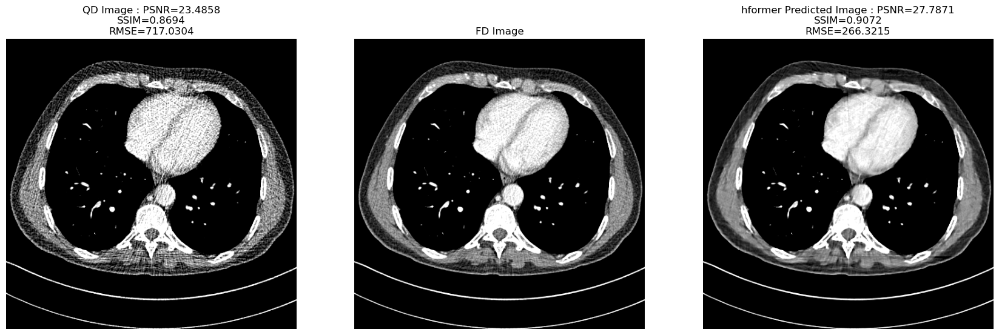

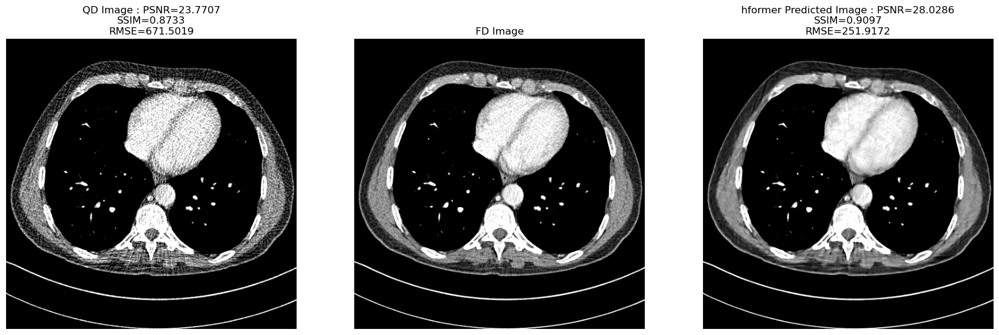

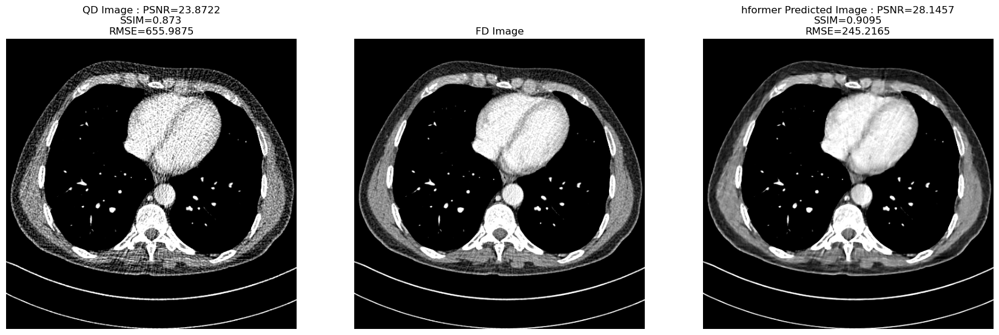

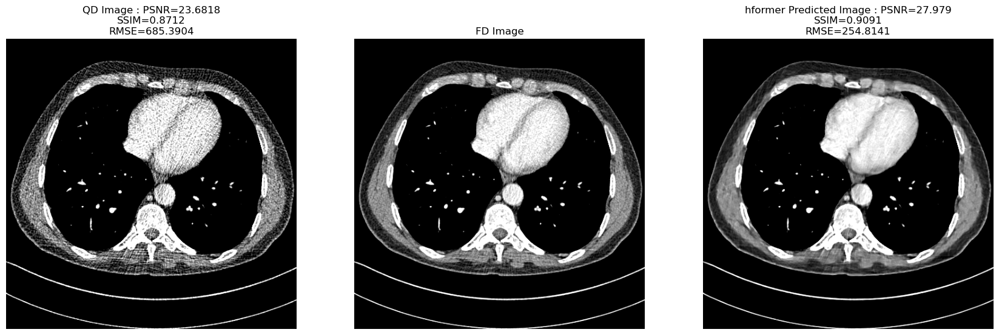

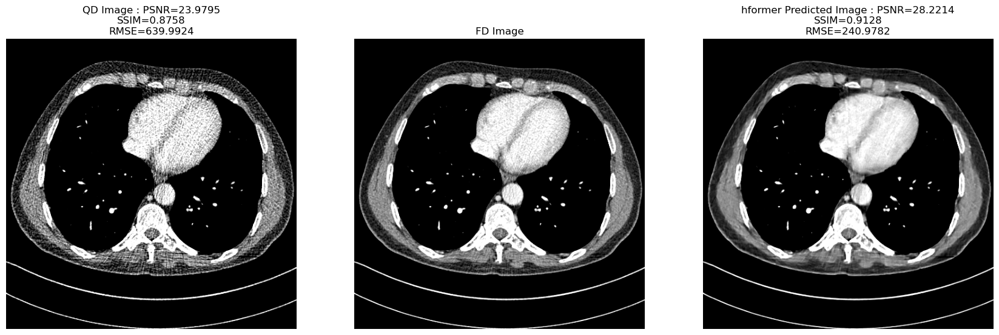

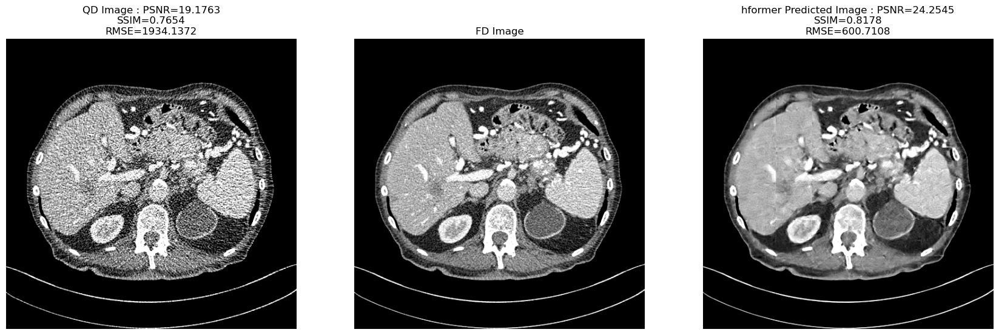

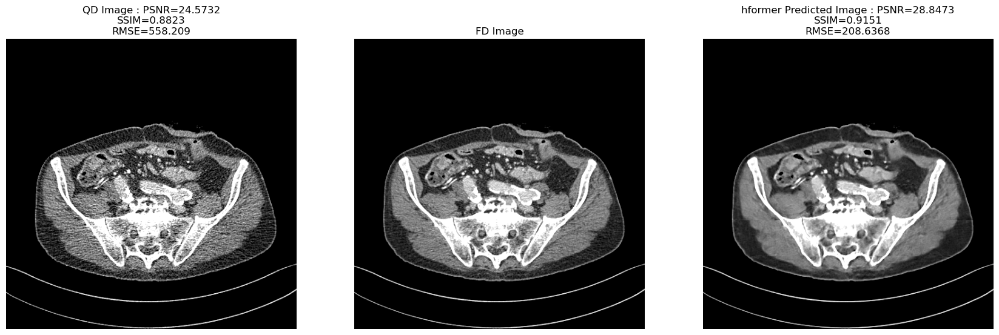

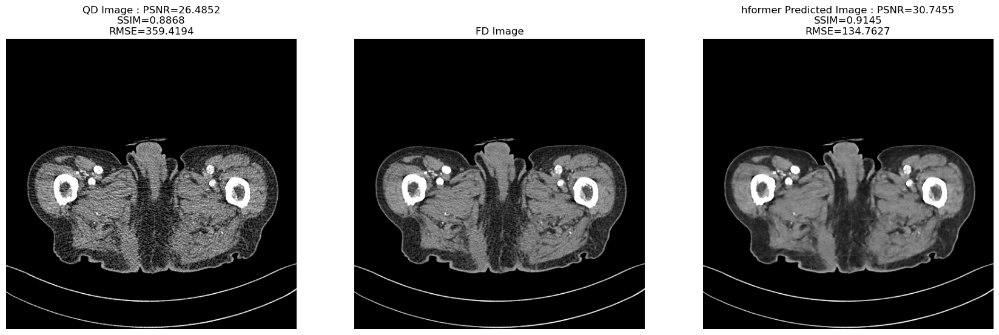

In [13]:

hformer_prediction_patches = hformer_model.predict(noisy_image_patches_array)
extended_hformer_prediction_patches = hformer_model.predict(extended_noisy_image_patches_array)

hformer_predictions = np.expand_dims(reconstruct_image_from_patches(hformer_prediction_patches[0:64], 8), axis=0)
extended_hformer_predictions = np.expand_dims(reconstruct_image_from_patches(extended_hformer_prediction_patches[0:64], 8), axis=0)

for i in range(1, int(hformer_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(hformer_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    hformer_predictions = np.append(hformer_predictions, reconstructed_image, axis=0)

for i in range(1, int(extended_hformer_prediction_patches.shape[0] / 64)): 
    extended_reconstructed_image = reconstruct_image_from_patches(extended_hformer_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    extended_reconstructed_image = np.expand_dims(extended_reconstructed_image, axis=0)

    extended_hformer_predictions = np.append(extended_hformer_predictions, extended_reconstructed_image, axis=0)
visualize_predictions(hformer_predictions, noisy_array, gt_array, len(gt_array), hformer_predictions, "hformer")

In [14]:
extended_hformer_metrics = get_average_metrics(extended_hformer_predictions, extended_gt_array, extended_noisy_array)
extended_hformer_metrics 

Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 27.523600831115917
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.8723555743844719
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 304.4095022895431


(27.5236, 0.8724, 304.4095, 4.7656, 0.044, -633.3049)

## Model 2 : XModel

In [15]:
from torchinfo import summary
sys.path.append('../denoising-models/novel_model/')
from x_denoiser import XModel 
x_model = XModel(num_channels=64)
x_model.load_state_dict(torch.load('../denoising-models/novel_model/weights/x_model/model_19.pth'))
x_model.eval()
print('Model summary : ')
print(summary(x_model))


Model summary : 
Layer (type:depth-idx)                        Param #
XModel                                        --
├─ConvTranspose2d: 1-1                        5
├─Conv2d: 1-2                                 16,448
├─InputProjectionLayer: 1-3                   --
│    └─Conv2d: 2-1                            640
├─OutputProjectionLayer: 1-4                  --
│    └─ConvTranspose2d: 2-2                   577
├─ConvBlock: 1-5                              --
│    └─ZeroPad2d: 2-3                         --
│    └─DepthWiseSeparableConv2d: 2-4          --
│    │    └─Conv2d: 3-1                       3,136
│    │    └─Conv2d: 3-2                       4,096
│    └─LayerNorm: 2-5                         --
│    └─Conv2d: 2-6                            803,072
│    └─GELU: 2-7                              --
│    └─Conv2d: 2-8                            16,448
├─ConvBlock: 1-6                              --
│    └─ZeroPad2d: 2-9                         --
│    └─DepthWiseSeparableCo

index ::  0.01 ssim ::  0.32642440284922
index ::  0.02 ssim ::  0.32642440284922
index ::  0.03 ssim ::  0.32642440284922
index ::  0.04 ssim ::  0.32642440284922
index ::  0.05 ssim ::  0.32642440284922
index ::  0.06 ssim ::  0.32642440284922
index ::  0.07 ssim ::  0.32642440284922
index ::  0.08 ssim ::  0.32642440284922
index ::  0.09 ssim ::  0.32642440284922
index ::  0.1 ssim ::  0.32642440284922
index ::  0.11 ssim ::  0.32642440284922
index ::  0.12 ssim ::  0.32642440284922
index ::  0.13 ssim ::  0.32642440284922
index ::  0.14 ssim ::  0.32642440284922
index ::  0.15 ssim ::  0.32642440284922
index ::  0.16 ssim ::  0.32642440284922
index ::  0.17 ssim ::  0.32642440284922
index ::  0.18 ssim ::  0.32642440284922
index ::  0.19 ssim ::  0.32642440284922
index ::  0.2 ssim ::  0.32642440284922
index ::  0.21 ssim ::  0.32642440284922
index ::  0.22 ssim ::  0.32642440284922
index ::  0.23 ssim ::  0.32642440284922
index ::  0.24 ssim ::  0.32642440284922
index ::  0.25 ssi

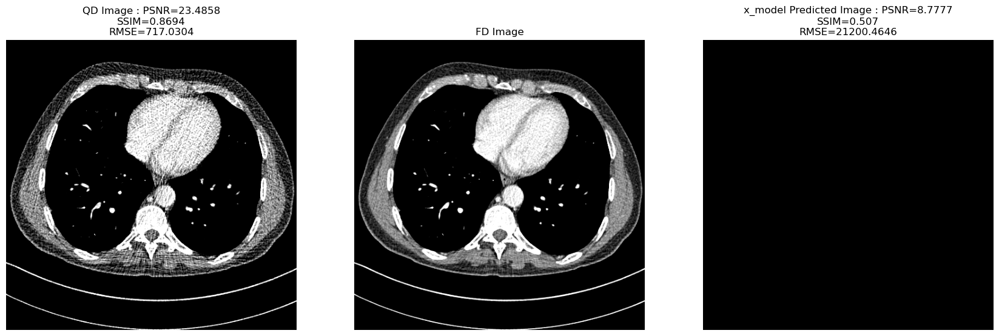

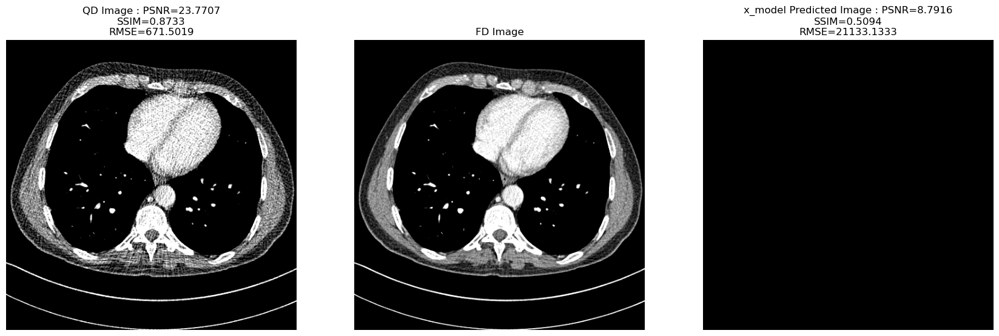

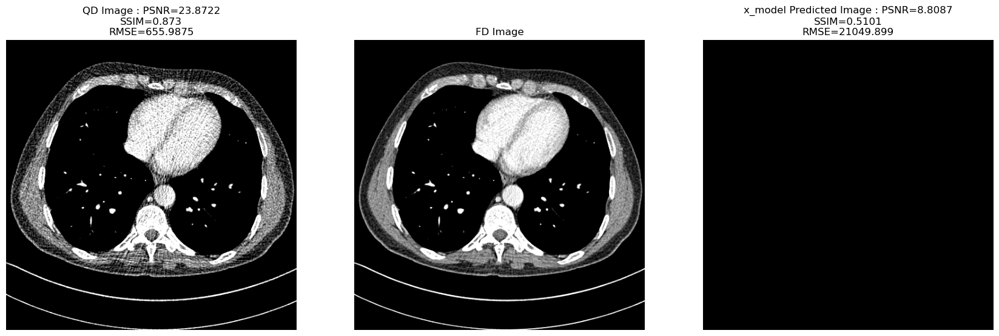

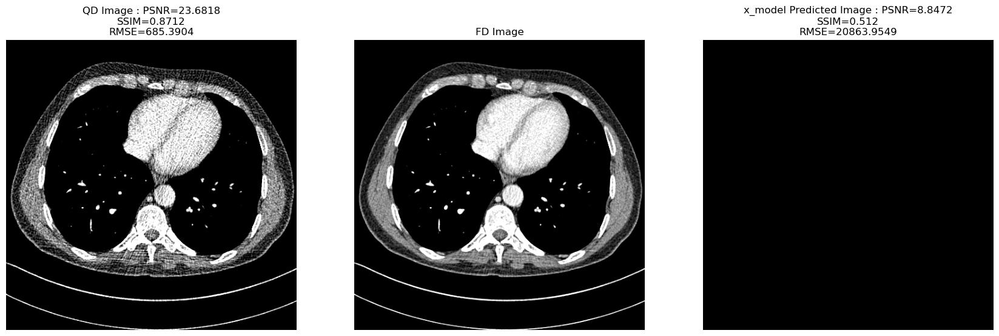

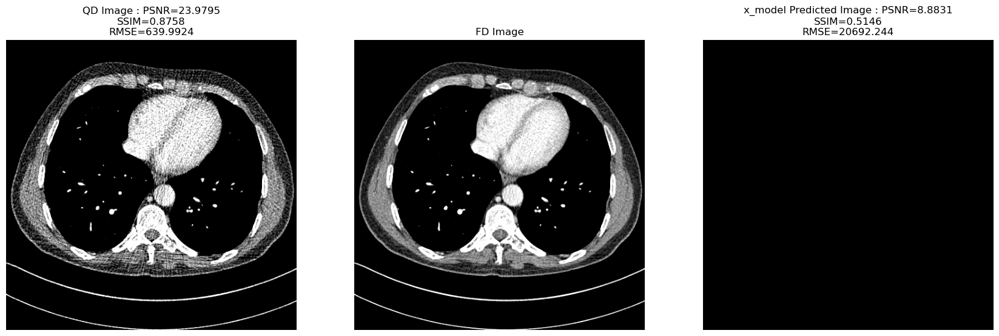

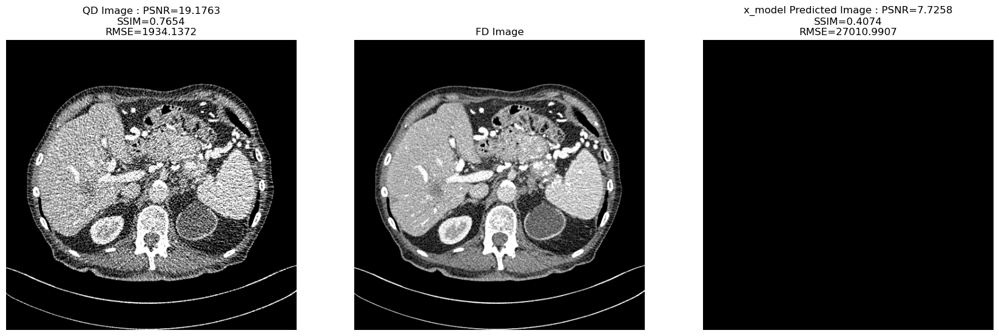

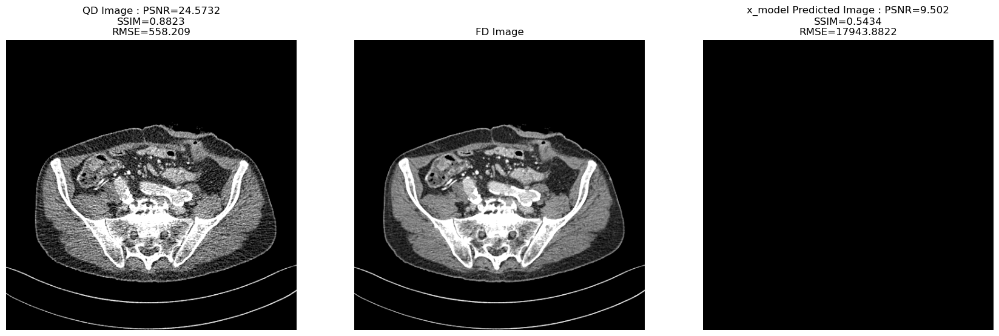

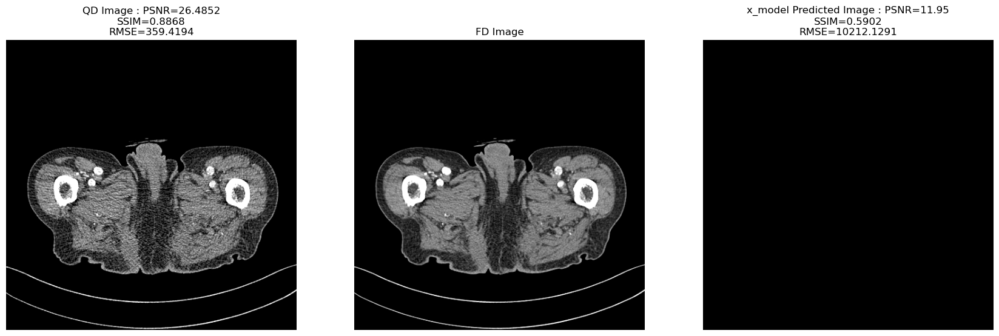

In [18]:
# Get prediction images.

x_model_prediction_patches = []
extended_x_model_prediction_patches = []

for img in noisy_array:
    img_tensor = torch.unsqueeze(torch.from_numpy(img).float(), 0)

    with torch.no_grad():
        output_tensor = x_model(img_tensor)
        output_tensor = output_tensor.cpu().numpy()

        x_model_prediction_patches.append(output_tensor)
    
for img in extended_noisy_array:
    img_tensor = torch.unsqueeze(torch.from_numpy(img).float(), 0)

    with torch.no_grad():

        output_tensor = x_model(img_tensor)
        output_tensor = output_tensor.cpu().numpy()

        
        noisy_reshaped = img_tensor.detach().cpu().numpy()
        noisy_reshaped = np.squeeze(noisy_reshaped, axis=-1)
        noisy_reshaped = np.squeeze(noisy_reshaped, axis=0)
        noisy_imfs = emd2d.emd(noisy_reshaped,max_imf=-1)

        pred_reshaped = output_tensor
        pred_reshaped = np.squeeze(pred_reshaped, axis=-1)
        pred_reshaped = np.squeeze(pred_reshaped, axis=0)
        pred_imfs = emd2d.emd(pred_reshaped, max_imf=-1)

        

        __ssim = 0
        best_performing_lerp_image = None

        for y in range(1, 100):
            x = y / 100.0
            swaped_IMFs = np.array([noisy_imfs[1] * x + pred_imfs[1] * (1.0 - x), pred_imfs[0] * (1.0 - x) + noisy_imfs[0] * x])
            predictions = torch.from_numpy(np.expand_dims(np.expand_dims(np.sum(swaped_IMFs, axis=0), -1), 0))

            _ssim = 0
            _ssim = calculate_ssim(trunc(denormalize(extended_gt_array[i])), trunc(denormalize(np.squeeze(predictions.detach().cpu().numpy(), axis=0))))
            print('index :: ', x, 'ssim :: ', _ssim)

            if _ssim > __ssim:
                __ssim = _ssim
                best_performing_lerp_image = predictions


        extended_x_model_prediction_patches.append(best_performing_lerp_image)

visualize_predictions(x_model, noisy_array, gt_array, len(gt_array), np.concatenate(x_model_prediction_patches,axis=0), "x_model")

In [19]:

extended_x_metrics= get_average_metrics(np.concatenate(extended_x_model_prediction_patches, axis=0), extended_gt_array, extended_noisy_array)
extended_x_metrics

Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 8.230388637628527
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.4309663508291881
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 24932.838737335205


(8.2304, 0.431, 24932.8387, -14.5276, -0.3974, 23995.1243)

## Model 3 : Y model B

In [20]:
sys.path.append('../denoising-models/mwcnn/')
from y_denoiser import YModel
y_model = YModel(num_channels=56)
y_model.load_state_dict(torch.load('../denoising-models/novel_model/weights/y_model/model_24.pth'))
y_model.eval()
print('Model summary : ')
print(summary(y_model))

Model summary : 
Layer (type:depth-idx)                        Param #
YModel                                        --
├─InputProjectionLayer: 1-1                   --
│    └─Conv2d: 2-1                            560
├─OutputProjectionLayer: 1-2                  --
│    └─ConvTranspose2d: 2-2                   505
├─ConvBlock: 1-3                              --
│    └─ZeroPad2d: 2-3                         --
│    └─DepthWiseSeparableConv2d: 2-4          --
│    │    └─Conv2d: 3-1                       2,744
│    │    └─Conv2d: 3-2                       3,136
│    └─LayerNorm: 2-5                         --
│    └─Conv2d: 2-6                            614,880
│    └─GELU: 2-7                              --
│    └─Conv2d: 2-8                            12,600
├─YBlock: 1-4                                 --
│    └─Linear: 2-9                            3,192
│    └─Linear: 2-10                           3,192
│    └─Linear: 2-11                           3,192
│    └─Conv2d: 2-12  

index ::  0.01 ssim ::  9.352684742731461e-05
index ::  0.02 ssim ::  9.81017115134463e-05
index ::  0.03 ssim ::  0.00010326638336696393
index ::  0.04 ssim ::  0.000109521081818861
index ::  0.05 ssim ::  0.00011567500566972465
index ::  0.06 ssim ::  0.000122663798440042
index ::  0.07 ssim ::  0.00012905466100669873
index ::  0.08 ssim ::  0.0001363950450352788
index ::  0.09 ssim ::  0.00014367969176150115
index ::  0.1 ssim ::  0.00015036351714105346
index ::  0.11 ssim ::  0.00015856310873510064
index ::  0.12 ssim ::  0.0001677499707705353
index ::  0.13 ssim ::  0.00017638688805018786
index ::  0.14 ssim ::  0.00018652671212762378
index ::  0.15 ssim ::  0.000197962917657427
index ::  0.16 ssim ::  0.0002089672842326865
index ::  0.17 ssim ::  0.00021945368788280184
index ::  0.18 ssim ::  0.00023104370164859497
index ::  0.19 ssim ::  0.0002430864331561959
index ::  0.2 ssim ::  0.000255709709050876
index ::  0.21 ssim ::  0.0002691212255851996
index ::  0.22 ssim ::  0.00028

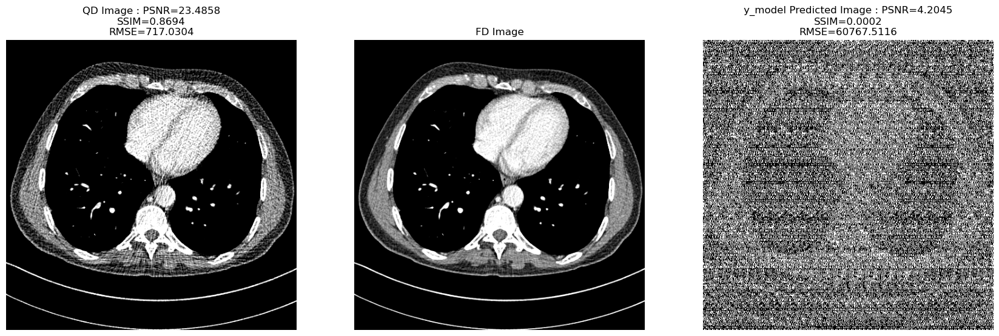

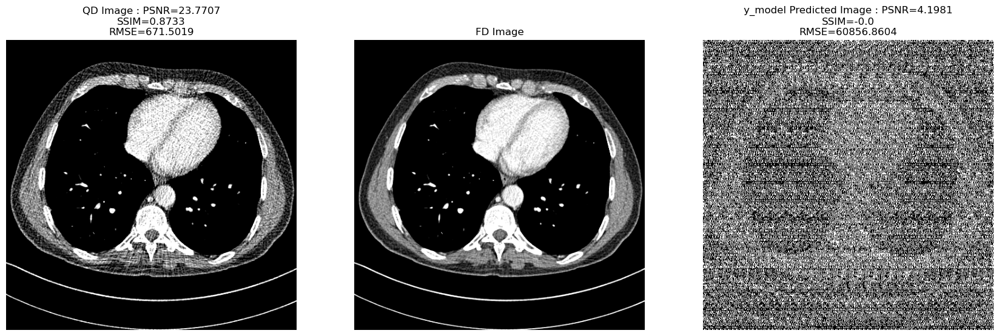

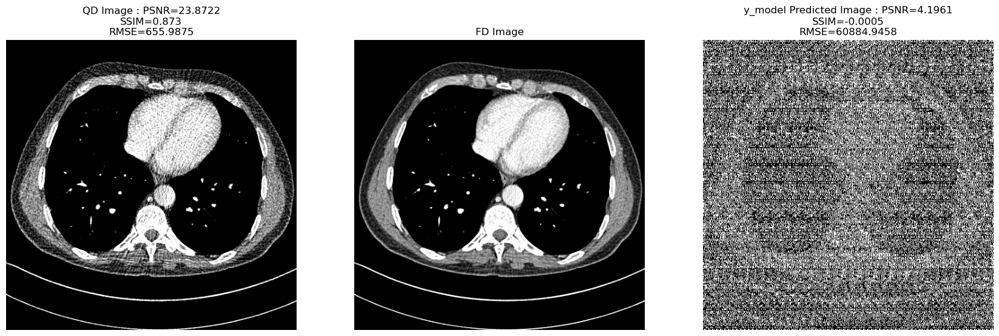

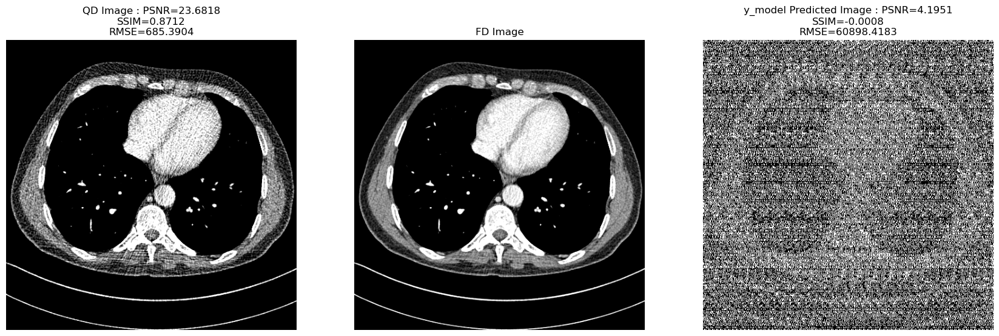

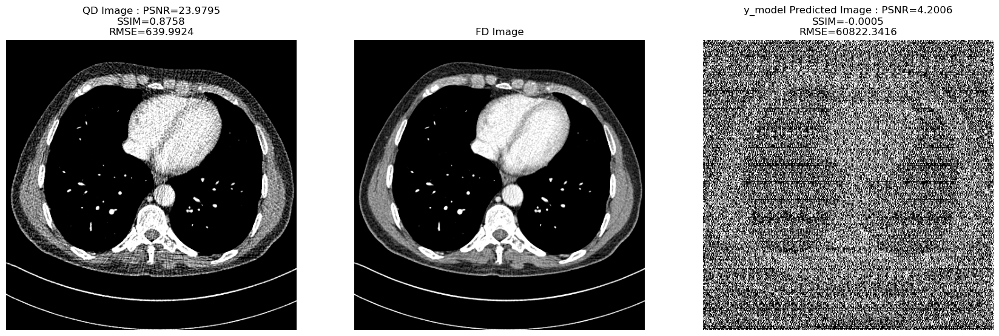

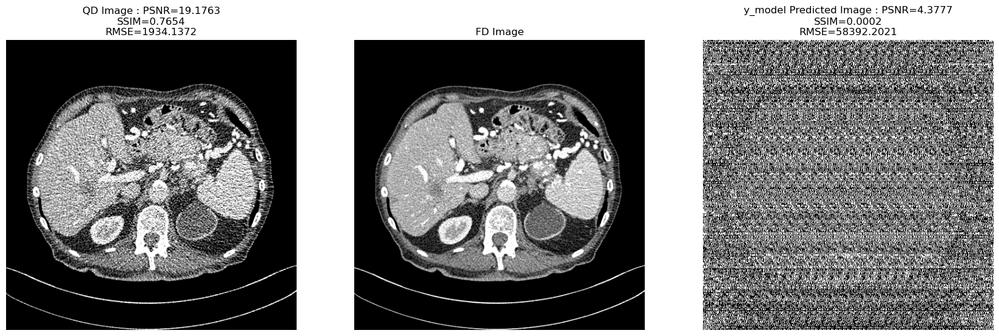

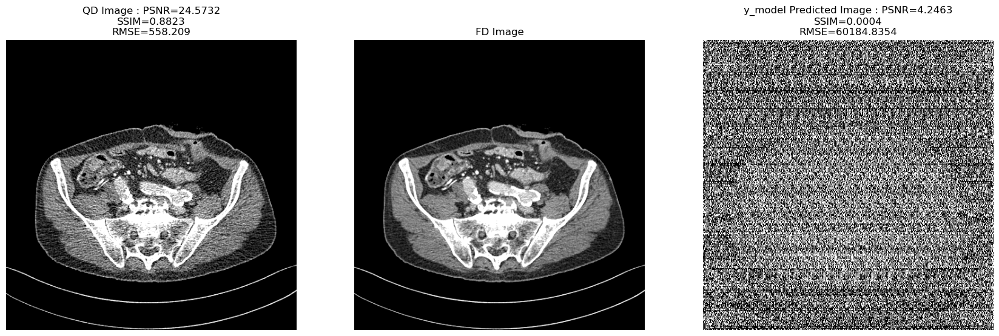

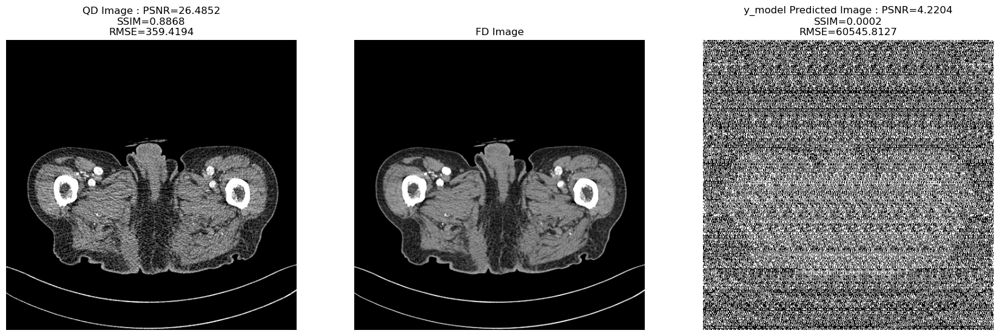

In [21]:
# Get prediction images.

y_model_prediction_patches = []
extended_y_model_prediction_patches = []

for img in noisy_array:
    img_tensor = torch.unsqueeze(torch.from_numpy(img).float(), dim=0)

    
    with torch.no_grad():
        output_tensor = y_model(img_tensor)
        output_tensor = output_tensor.cpu().numpy()

        y_model_prediction_patches.append(output_tensor)
    
   
for img in extended_noisy_array:
    img_tensor = torch.unsqueeze(torch.from_numpy(img).float(), 0)

    with torch.no_grad():
        output_tensor = y_model(img_tensor)
        output_tensor = output_tensor.cpu().numpy()

        
        noisy_reshaped = img_tensor.detach().cpu().numpy()
        noisy_reshaped = np.squeeze(noisy_reshaped, axis=-1)
        noisy_reshaped = np.squeeze(noisy_reshaped, axis=0)
        noisy_imfs = emd2d.emd(noisy_reshaped,max_imf=-1)

        pred_reshaped = output_tensor
        pred_reshaped = np.squeeze(pred_reshaped, axis=-1)
        pred_reshaped = np.squeeze(pred_reshaped, axis=0)
        pred_imfs = emd2d.emd(pred_reshaped, max_imf=-1)

        
        __ssim = 0
        best_performing_lerp_image = None

        for y in range(1, 100):
            x = y / 100.0
            swaped_IMFs = np.array([noisy_imfs[1] * x + pred_imfs[1] * (1.0 - x), pred_imfs[0] * (1.0 - x) + noisy_imfs[0] * x])
            predictions = torch.from_numpy(np.expand_dims(np.expand_dims(np.sum(swaped_IMFs, axis=0), -1), 0))

            _ssim = calculate_ssim(trunc(denormalize(extended_gt_array[i])), trunc(denormalize(np.squeeze(predictions.detach().cpu().numpy(), axis=0))))
            print('index :: ', x, 'ssim :: ', _ssim)

            if _ssim > __ssim:
                __ssim = _ssim
                best_performing_lerp_image = predictions



        extended_y_model_prediction_patches.append(best_performing_lerp_image)
    

visualize_predictions(y_model, noisy_array, gt_array, len(gt_array), np.concatenate(y_model_prediction_patches,axis=0), "y_model")

In [22]:

extended_y_metrics= get_average_metrics(np.concatenate(extended_y_model_prediction_patches, axis=0), extended_gt_array, extended_noisy_array)
extended_y_metrics

Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 19.750717346555913
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.7671985375126102
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 1751.881920406272


(19.7507, 0.7672, 1751.8819, -3.0073, -0.0611, 814.1675)

# Model 3 : SAB Model

In [23]:

sys.path.append('../denoising-models/hformer_self_attention')
from torchinfo import summary


from hformer_sa_model import HformerSAModel 

sa_model = HformerSAModel(num_channels=64).cuda()
sa_model.load_state_dict(torch.load('../denoising-models/hformer_self_attention/weights/model_75.pth'))
sa_model.eval()
print('model summary\n', summary(sa_model, input_size=(64, 64, 64, 1)))


model summary
Layer (type:depth-idx)                        Output Shape              Param #
HformerSAModel                                [64, 64, 64, 1]           --
├─InputProjectionLayer: 1-1                   [64, 64, 64, 64]          --
│    └─Conv2d: 2-1                            [64, 64, 64, 64]          640
├─ConvBlock: 1-2                              [64, 64, 64, 64]          --
│    └─ZeroPad2d: 2-2                         [64, 64, 18, 18]          --
│    └─DepthWiseSeparableConv2d: 2-3          [64, 64, 18, 18]          --
│    │    └─Conv2d: 3-1                       [64, 64, 18, 18]          3,136
│    │    └─Conv2d: 3-2                       [64, 64, 18, 18]          4,096
│    └─Conv2d: 2-4                            [64, 256, 12, 12]         803,072
│    └─GELU: 2-5                              [64, 256, 12, 12]         --
│    └─Conv2d: 2-6                            [64, 64, 12, 12]          16,448
│    └─ZeroPad2d: 2-7                         [64, 64, 18, 18]   

In [24]:

sa_prediction_patches = []
extended_sa_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(noisy_image_patches_array):
        noisy = data
    
        predictions = sa_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        sa_prediction_patches.append(predictions.detach().cpu())
    
sa_prediction_patches = np.concatenate(sa_prediction_patches, axis=0)
sa_predictions = np.expand_dims(reconstruct_image_from_patches(sa_prediction_patches[0:64], 8), axis=0)


for i in range(1, int(sa_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(sa_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    sa_predictions= np.append(sa_predictions, reconstructed_image, axis=0)


with torch.no_grad():    
    for i, data in enumerate(extended_noisy_image_patches_array):
        noisy = data
    
        predictions = sa_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        extended_sa_prediction_patches.append(predictions.detach().cpu())
    
extended_sa_prediction_patches = np.concatenate(extended_sa_prediction_patches, axis=0)
extended_sa_predictions = np.expand_dims(reconstruct_image_from_patches(extended_sa_prediction_patches[0:64], 8), axis=0)



index ::  0.01 ssim ::  -0.00044873314391785446
index ::  0.02 ssim ::  -0.00044073932652606096
index ::  0.03 ssim ::  -0.00043223108355827997
index ::  0.04 ssim ::  -0.0004233737644790591
index ::  0.05 ssim ::  -0.00041334262137890105
index ::  0.06 ssim ::  -0.00040248329470719986
index ::  0.07 ssim ::  -0.00039074883618523857
index ::  0.08 ssim ::  -0.0003778481270926029
index ::  0.09 ssim ::  -0.0003649225757896087
index ::  0.1 ssim ::  -0.0003513520044259279
index ::  0.11 ssim ::  -0.0003367872096398663
index ::  0.12 ssim ::  -0.000321573818806709
index ::  0.13 ssim ::  -0.00030483733055118855
index ::  0.14 ssim ::  -0.0002864815557219327
index ::  0.15 ssim ::  -0.0002677359417928358
index ::  0.16 ssim ::  -0.0002474284991636655
index ::  0.17 ssim ::  -0.00022641655935355244
index ::  0.18 ssim ::  -0.00020449625232964256
index ::  0.19 ssim ::  -0.00018159339420915547
index ::  0.2 ssim ::  -0.0001574648545642795
index ::  0.21 ssim ::  -0.00013307797095876323
index

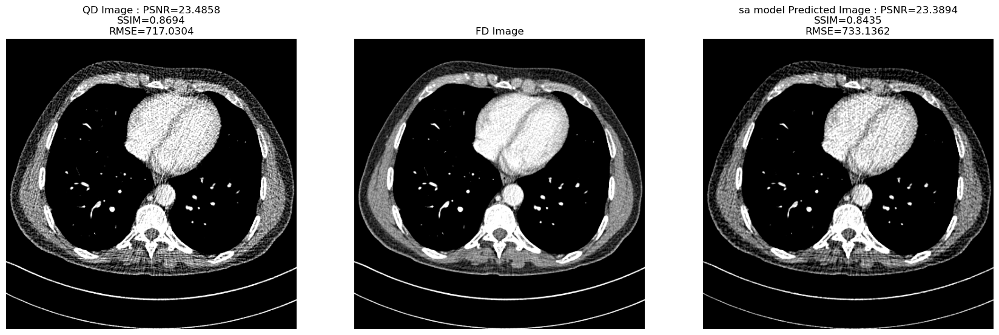

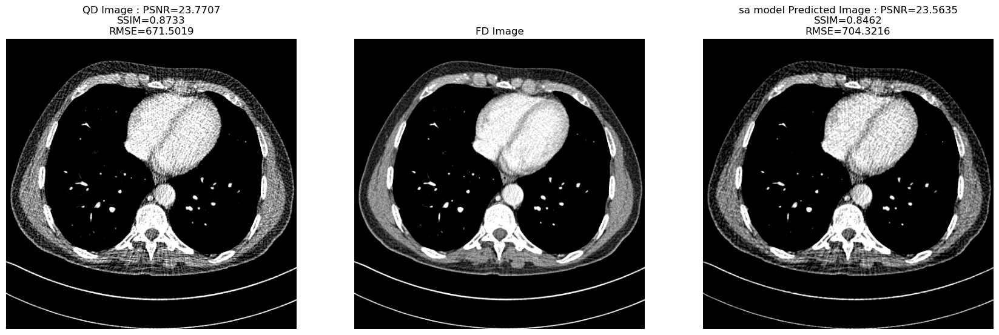

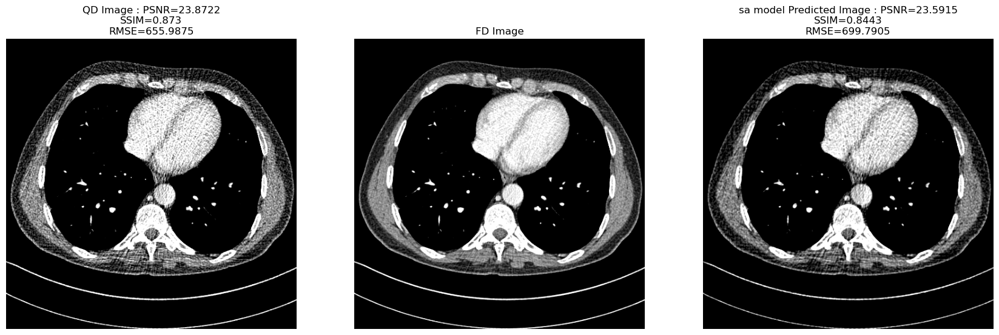

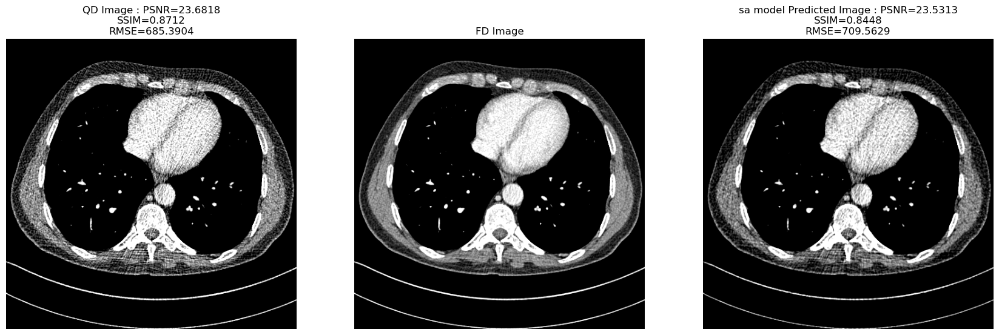

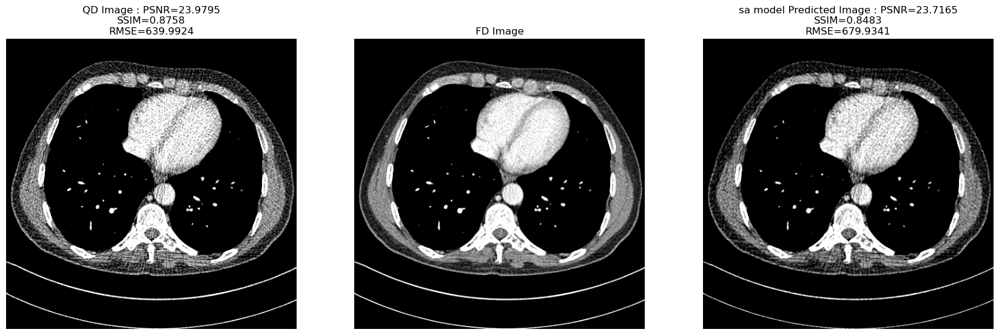

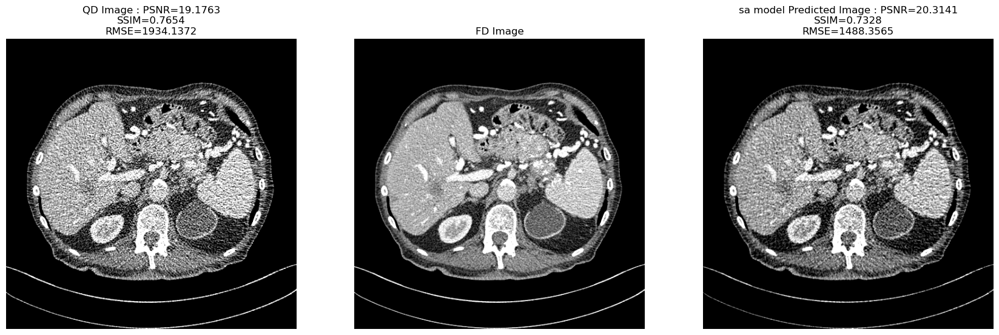

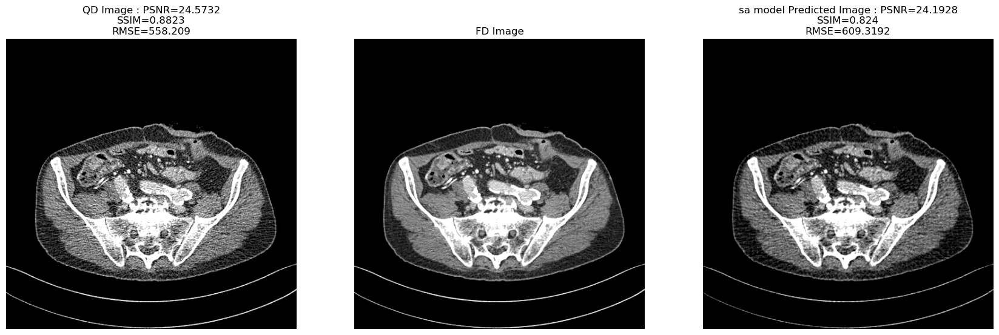

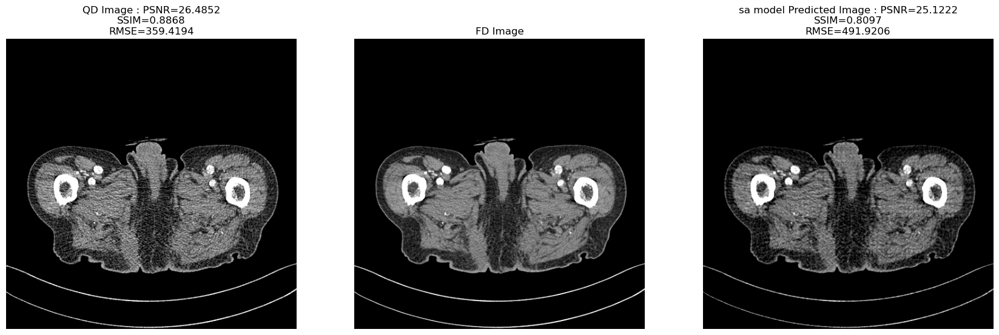

In [25]:

for i in range(1, int(extended_sa_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(extended_sa_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

  
    __ssim = 0
    best_performing_lerp_image = None
    
    noisy_reshaped = np.squeeze(extended_noisy_array[i], -1)
    print(noisy_reshaped.shape)
    noisy_imfs = emd2d.emd(noisy_reshaped,max_imf=-1)

    for y in range(1, 100):
        x = y / 100.0
        swaped_IMFs = np.array([noisy_imfs[1] * x + pred_imfs[1] * (1.0 - x), pred_imfs[0] * (1.0 - x) + noisy_imfs[0] * x])
        predictions = torch.from_numpy(np.expand_dims(np.expand_dims(np.sum(swaped_IMFs, axis=0), -1), 0))

        _ssim = calculate_ssim(trunc(denormalize(extended_gt_array[i])), trunc(denormalize(np.squeeze(predictions.detach().cpu().numpy(), axis=0))))
        print('index :: ', x, 'ssim :: ', _ssim)

        if _ssim > __ssim:
            __ssim = _ssim
            best_performing_lerp_image = predictions



    extended_sa_predictions= np.append(best_performing_lerp_image, predictions, axis=0)

visualize_predictions(sa_model, noisy_array, gt_array, len(gt_array), sa_predictions, "sa model")

In [26]:

extended_sa_metrics = get_average_metrics(extended_sa_predictions, extended_gt_array, extended_noisy_array)
extended_sa_metrics

Original average gt-noisy PSNR -> 0.4725655172456116
Predicted average gt-predicted PSNR -> 0.15868219793549604
Original average gt-noisy SSIM -> 0.017427126660285834
Predicted average gt-predicted SSIM -> 0.007102037575166409
Original average gt-noisy MSE-> 13.885322647094727
Predicted average gt-predicted MSE-> 514.9192796170271


(0.1587, 0.0071, 514.9193, -0.3139, -0.0103, 501.034)

# Model 4 : ZB Model

In [11]:

sys.path.append('../denoising-models/hformer_pytorch')
from torchinfo import summary

from z_model import ZModel 

z_model = ZModel(num_channels=16).cuda()
z_model.load_state_dict(torch.load('../denoising-models/hformer_pytorch/weights/z_model_159.pth'))
z_model.eval()
print('model summary\n', summary(z_model, input_size=(64, 64, 64, 1)))

Using cache found in C:\Users\Tarun/.cache\torch\hub\mateuszbuda_brain-segmentation-pytorch_master
Using cache found in C:\Users\Tarun/.cache\torch\hub\mateuszbuda_brain-segmentation-pytorch_master


model summary
Layer (type:depth-idx)                        Output Shape              Param #
ZModel                                        [64, 64, 64, 1]           --
├─InputProjectionLayer: 1-1                   [64, 16, 64, 64]          --
│    └─Conv2d: 2-1                            [64, 16, 64, 64]          160
├─UNet: 1-2                                   [64, 16, 64, 64]          --
│    └─Sequential: 2-2                        [64, 16, 64, 64]          --
│    │    └─Conv2d: 3-1                       [64, 16, 64, 64]          2,304
│    │    └─BatchNorm2d: 3-2                  [64, 16, 64, 64]          32
│    │    └─ReLU: 3-3                         [64, 16, 64, 64]          --
│    │    └─Conv2d: 3-4                       [64, 16, 64, 64]          2,304
│    │    └─BatchNorm2d: 3-5                  [64, 16, 64, 64]          32
│    │    └─ReLU: 3-6                         [64, 16, 64, 64]          --
│    └─MaxPool2d: 2-3                         [64, 16, 32, 32]          --

In [15]:

z_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(noisy_image_patches_array):
        noisy = data
    
        predictions = z_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        z_prediction_patches.append(predictions.detach().cpu())
    
z_prediction_patches = np.concatenate(z_prediction_patches, axis=0)
z_predictions = np.expand_dims(reconstruct_image_from_patches(z_prediction_patches[0:64], 8), axis=0)


for i in range(1, int(z_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(z_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    z_predictions= np.append(z_predictions, reconstructed_image, axis=0)

extended_z_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(extended_noisy_image_patches_array):
        noisy = data
    
        predictions = z_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        extended_z_prediction_patches.append(predictions.detach().cpu())
    
extended_z_prediction_patches = np.concatenate(extended_z_prediction_patches, axis=0)
extended_z_predictions = np.expand_dims(reconstruct_image_from_patches(extended_z_prediction_patches[0:64], 8), axis=0)




In [16]:

for i in range(1, int(extended_z_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(extended_z_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    extended_z_predictions= np.append(extended_z_predictions, reconstructed_image, axis=0)
 
emd_extended_z_predictions = [None] * extended_z_predictions.shape[0]
for i in range(extended_z_predictions.shape[0]):

    noisy_reshaped = np.squeeze(extended_noisy_array[i], -1)
    print(noisy_reshaped.shape)
    noisy_imfs = emd2d.emd(noisy_reshaped,max_imf=-1)

    pred_reshaped = extended_z_predictions[i]
    pred_reshaped = np.squeeze(pred_reshaped, axis=-1)
    pred_imfs = emd2d.emd(pred_reshaped, max_imf=-1)

    __ssim = 0
    best_performing_lerp_image = None

    for y in range(1, 2):
        x = 0.44
        swaped_IMFs = np.array([noisy_imfs[1] * x + pred_imfs[1] * (1.0 - x), pred_imfs[0] * (1.0 - x) + noisy_imfs[0] * x])
        predictions = torch.from_numpy(np.expand_dims(np.expand_dims(np.sum(swaped_IMFs, axis=0), -1), 0))

        _ssim = calculate_ssim(trunc(denormalize(extended_gt_array[i])), trunc(denormalize(np.squeeze(predictions.detach().cpu().numpy(), axis=0))))
        print('index :: ', x, 'ssim :: ', _ssim)

        if _ssim > __ssim:
            __ssim = _ssim
            best_performing_lerp_image = predictions

    emd_extended_z_predictions[i] = best_performing_lerp_image

(512, 512)
index ::  0.44 ssim ::  0.7396790386508157
(512, 512)
index ::  0.44 ssim ::  0.7434523912731732
(512, 512)
index ::  0.44 ssim ::  0.7438379586335572
(512, 512)
index ::  0.44 ssim ::  0.7417920103503808
(512, 512)
index ::  0.44 ssim ::  0.7496923958509866
(512, 512)
index ::  0.44 ssim ::  0.7520462169361256
(512, 512)
index ::  0.44 ssim ::  0.7450142332048688
(512, 512)
index ::  0.44 ssim ::  0.7545065410493944
(512, 512)
index ::  0.44 ssim ::  0.7557541348996031
(512, 512)
index ::  0.44 ssim ::  0.749527103385977
(512, 512)
index ::  0.44 ssim ::  0.7651107748960474
(512, 512)
index ::  0.44 ssim ::  0.7641277666110423
(512, 512)
index ::  0.44 ssim ::  0.7618571979849029
(512, 512)
index ::  0.44 ssim ::  0.7701111895808634
(512, 512)
index ::  0.44 ssim ::  0.7722665914474767
(512, 512)
index ::  0.44 ssim ::  0.7629333782886553
(512, 512)
index ::  0.44 ssim ::  0.7711013262779441
(512, 512)
index ::  0.44 ssim ::  0.7741384406542298
(512, 512)
index ::  0.44 ssi

In [18]:

emd_numpy_z_pred = []

for x in emd_extended_z_predictions:
    emd_numpy_z_pred.append(np.squeeze(x.numpy(), 0))

emd_numpy_z_pred = np.array(emd_numpy_z_pred)

In [19]:

extended_z_metrics = get_average_metrics(emd_numpy_z_pred, extended_gt_array, extended_noisy_array)
extended_z_metrics

Original average gt-noisy PSNR -> 20.34302572352254
Predicted average gt-predicted PSNR -> 22.660864854381984
Original average gt-noisy SSIM -> 0.6578515451161205
Predicted average gt-predicted SSIM -> 0.7248658707129578
Original average gt-noisy MSE-> 1549.707098236084
Predicted average gt-predicted MSE-> 904.5884914777207


(22.6609, 0.7249, 904.5885, 2.3178, 0.067, -645.1186)

# Model 5 : WB Model

In [31]:


sys.path.append('../denoising-models/hformer_pytorch')
from torchinfo import summary

from w_model import WModel 

w_model = WModel(num_channels=32).cuda()
w_model.load_state_dict(torch.load('../denoising-models/hformer_pytorch/weights/model_278.pth'))
w_model.eval()
print('model summary\n', summary(w_model, input_size=(64, 64, 64, 1)))

Using cache found in C:\Users\Tarun/.cache\torch\hub\mateuszbuda_brain-segmentation-pytorch_master
Using cache found in C:\Users\Tarun/.cache\torch\hub\mateuszbuda_brain-segmentation-pytorch_master


model summary
Layer (type:depth-idx)                   Output Shape              Param #
WModel                                   [64, 64, 64, 1]           --
├─InputProjectionLayer: 1-1              [64, 32, 64, 64]          --
│    └─Conv2d: 2-1                       [64, 32, 64, 64]          320
├─UNet: 1-2                              [64, 32, 64, 64]          --
│    └─Sequential: 2-2                   [64, 32, 64, 64]          --
│    │    └─Conv2d: 3-1                  [64, 32, 64, 64]          9,216
│    │    └─BatchNorm2d: 3-2             [64, 32, 64, 64]          64
│    │    └─ReLU: 3-3                    [64, 32, 64, 64]          --
│    │    └─Conv2d: 3-4                  [64, 32, 64, 64]          9,216
│    │    └─BatchNorm2d: 3-5             [64, 32, 64, 64]          64
│    │    └─ReLU: 3-6                    [64, 32, 64, 64]          --
│    └─MaxPool2d: 2-3                    [64, 32, 32, 32]          --
│    └─Sequential: 2-4                   [64, 64, 32, 32]       

(512, 512)
index ::  0.1 ssim ::  0.9128591267962065
index ::  0.2 ssim ::  0.911162407467579
index ::  0.3 ssim ::  0.9079188839120906
index ::  0.4 ssim ::  0.9036313039637258
index ::  0.45 ssim ::  0.9011812312571469
index ::  0.47 ssim ::  0.9001606419860333
index ::  0.49 ssim ::  0.8991129746245822
index ::  0.5 ssim ::  0.8985932757352144
index ::  0.51 ssim ::  0.8980670891594634
index ::  0.55 ssim ::  0.8958991136782634
index ::  0.6 ssim ::  0.8931073756900998
index ::  0.7 ssim ::  0.8873161876450798
index ::  0.8 ssim ::  0.8813867502245728
index ::  0.9 ssim ::  0.8753996191817526
index ::  1.0 ssim ::  0.8693744246881713
(512, 512)
index ::  0.1 ssim ::  0.9158884337402593
index ::  0.2 ssim ::  0.9142173198403081
index ::  0.3 ssim ::  0.9110998489236807
index ::  0.4 ssim ::  0.9069354948142201
index ::  0.45 ssim ::  0.9045715231017359
index ::  0.47 ssim ::  0.9035862758777472
index ::  0.49 ssim ::  0.9025683201672027
index ::  0.5 ssim ::  0.9020588375302049
index

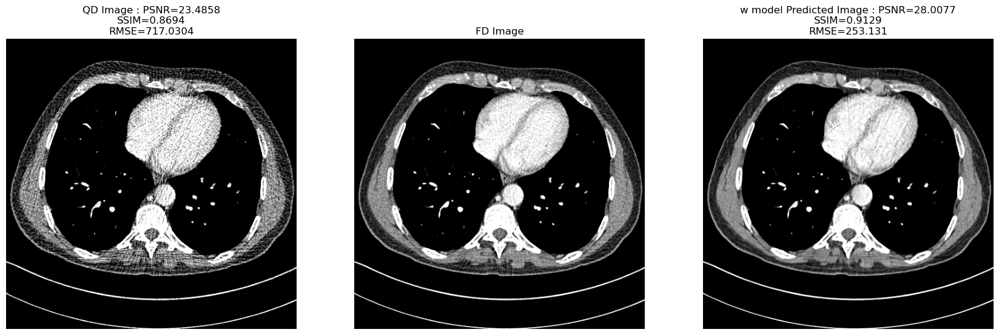

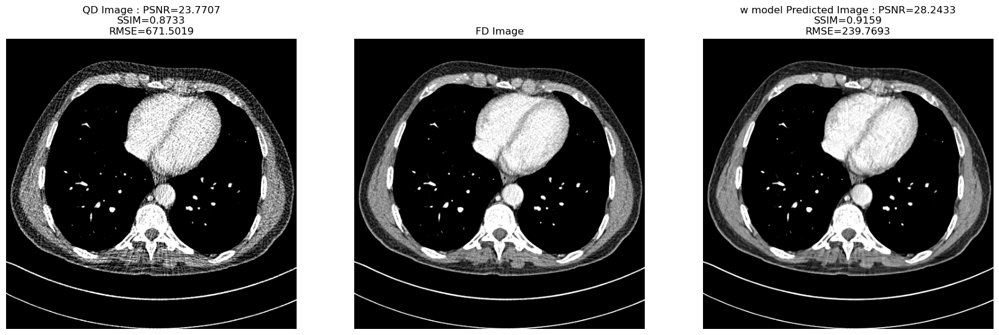

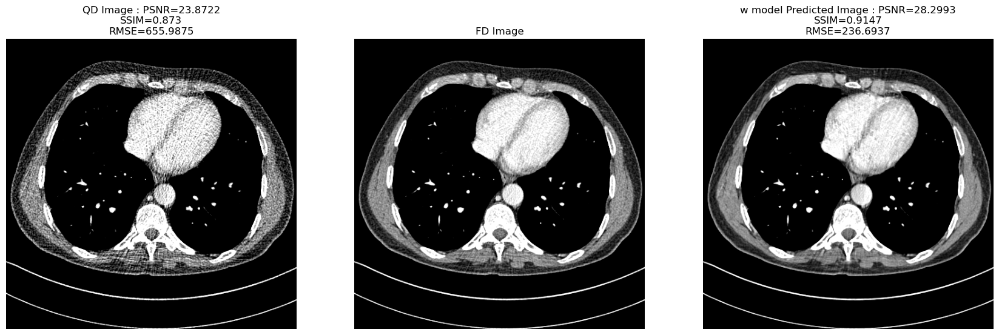

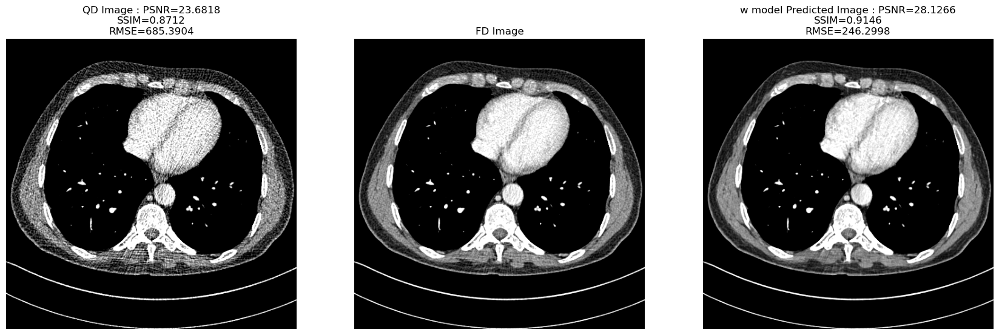

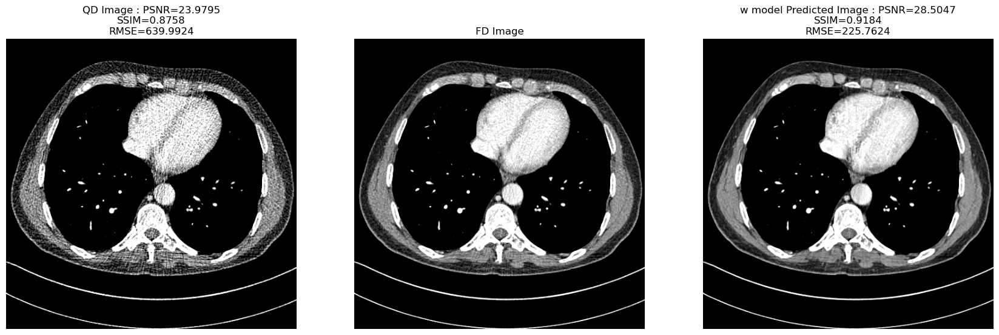

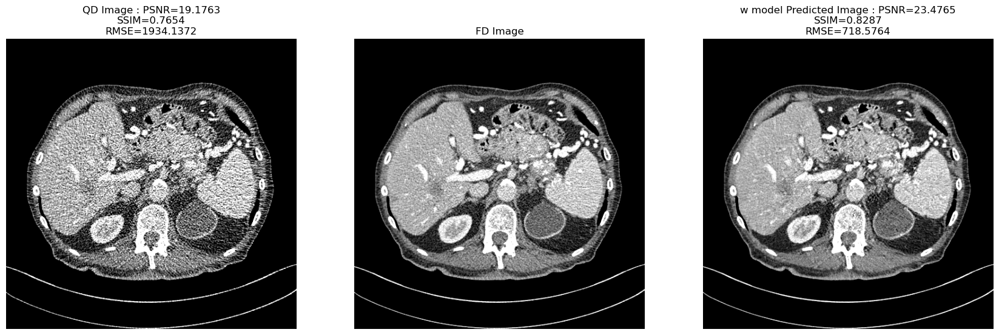

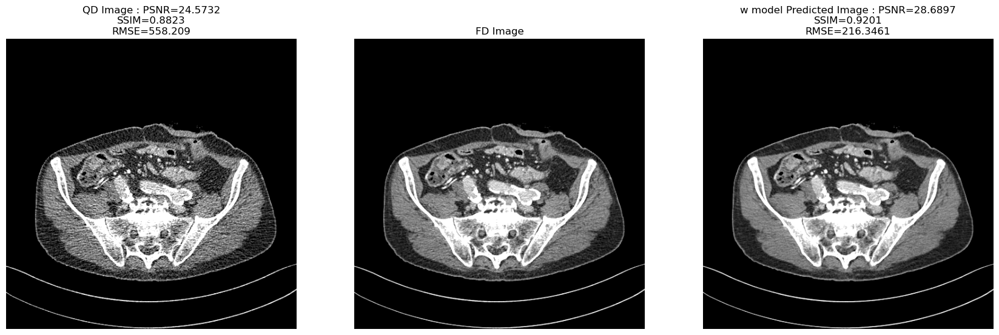

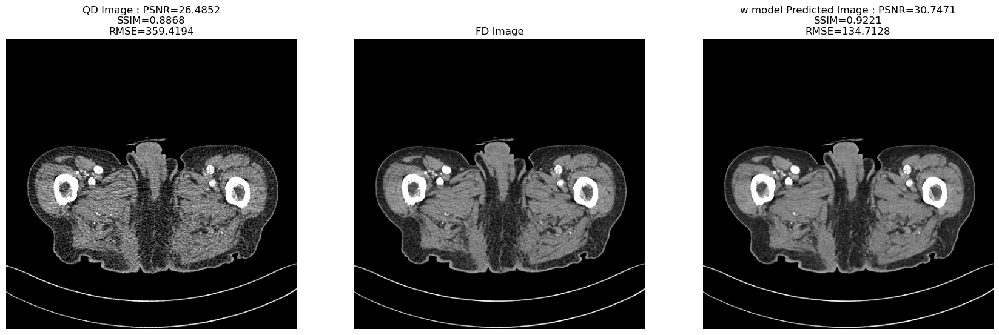

In [32]:

w_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(noisy_image_patches_array):
        noisy = data
    
        predictions = w_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        w_prediction_patches.append(predictions.detach().cpu())
    
w_prediction_patches = np.concatenate(w_prediction_patches, axis=0)

w_predictions = np.expand_dims(reconstruct_image_from_patches(w_prediction_patches[0:64], 8), axis=0)


for i in range(1, int(w_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(w_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    w_predictions= np.append(w_predictions, reconstructed_image, axis=0)

# In extended_w_predictions, do EMD

emd_predictions = [None] * w_predictions.shape[0]
for i in range(w_predictions.shape[0]):

    noisy_reshaped = np.squeeze(noisy_array[i], -1)
    print(noisy_reshaped.shape)
    noisy_imfs = emd2d.emd(noisy_reshaped,max_imf=-1)

    pred_reshaped = w_predictions[i]
    pred_reshaped = np.squeeze(pred_reshaped, axis=-1)
    pred_imfs = emd2d.emd(pred_reshaped, max_imf=-1)

    __ssim = 0
    best_performing_lerp_image = None

    for x in [0.1, 0.2, 0.3, 0.4, 0.45, 0.47, 0.49, 0.5, 0.51, 0.55, 0.6, 0.7, 0.8, 0.9, 1.0]:
        swaped_IMFs = np.array([noisy_imfs[1] * x + pred_imfs[1] * (1.0 - x), pred_imfs[0] * (1.0 - x) + noisy_imfs[0] * x])
        predictions = torch.from_numpy(np.expand_dims(np.expand_dims(np.sum(swaped_IMFs, axis=0), -1), 0))

        _ssim = calculate_ssim(trunc(denormalize(gt_array[i])), trunc(denormalize(np.squeeze(predictions.detach().cpu().numpy(), axis=0))))
        print('index :: ', x, 'ssim :: ', _ssim)

        if _ssim > __ssim:
            __ssim = _ssim
            best_performing_lerp_image = predictions

    w_predictions[i] = best_performing_lerp_image

visualize_predictions(w_model, noisy_array, gt_array, len(gt_array), w_predictions, "w model")

In [33]:

extended_w_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(extended_noisy_image_patches_array):
        noisy = data
    
        predictions = w_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        extended_w_prediction_patches.append(predictions.detach().cpu())
    
extended_w_prediction_patches = np.concatenate(extended_w_prediction_patches, axis=0)

extended_w_predictions = np.expand_dims(reconstruct_image_from_patches(extended_w_prediction_patches[0:64], 8), axis=0)


for i in range(1, int(extended_w_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(extended_w_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    extended_w_predictions= np.append(extended_w_predictions, reconstructed_image, axis=0)

# In extended_w_predictions, do EMD

emd_extended_w_predictions = [None] * extended_w_predictions.shape[0]
for i in range(extended_w_predictions.shape[0]):

    noisy_reshaped = np.squeeze(extended_noisy_array[i], -1)
    print(noisy_reshaped.shape)
    noisy_imfs = emd2d.emd(noisy_reshaped,max_imf=-1)

    pred_reshaped = extended_w_predictions[i]
    pred_reshaped = np.squeeze(pred_reshaped, axis=-1)
    pred_imfs = emd2d.emd(pred_reshaped, max_imf=-1)

    __ssim = 0
    best_performing_lerp_image = None

    for y in range(1, 100):
        x = y / 100.0
        swaped_IMFs = np.array([noisy_imfs[1] * x + pred_imfs[1] * (1.0 - x), pred_imfs[0] * (1.0 - x) + noisy_imfs[0] * x])
        predictions = torch.from_numpy(np.expand_dims(np.expand_dims(np.sum(swaped_IMFs, axis=0), -1), 0))

        _ssim = calculate_ssim(trunc(denormalize(extended_gt_array[i])), trunc(denormalize(np.squeeze(predictions.detach().cpu().numpy(), axis=0))))
        print('index :: ', x, 'ssim :: ', _ssim)

        if _ssim > __ssim:
            __ssim = _ssim
            best_performing_lerp_image = predictions

    emd_extended_w_predictions[i] = best_performing_lerp_image


(512, 512)
index ::  0.01 ssim ::  0.912644874930654
index ::  0.02 ssim ::  0.9127830914775501
index ::  0.03 ssim ::  0.9128595715403485
index ::  0.04 ssim ::  0.9129253499598527
index ::  0.05 ssim ::  0.9129629216949284
index ::  0.06 ssim ::  0.9129756737986254
index ::  0.07 ssim ::  0.9129804960127416
index ::  0.08 ssim ::  0.9129634402337629
index ::  0.09 ssim ::  0.9129138200388135
index ::  0.1 ssim ::  0.9128591267962065
index ::  0.11 ssim ::  0.9127606473961376
index ::  0.12 ssim ::  0.9126641171240119
index ::  0.13 ssim ::  0.912533322110789
index ::  0.14 ssim ::  0.9123831469739081
index ::  0.15 ssim ::  0.9122353606850733
index ::  0.16 ssim ::  0.9120501900711925
index ::  0.17 ssim ::  0.911850851954758
index ::  0.18 ssim ::  0.9116227671747842
index ::  0.19 ssim ::  0.9114120774380275
index ::  0.2 ssim ::  0.9111623826005542
index ::  0.21 ssim ::  0.9108902728491908
index ::  0.22 ssim ::  0.9106127008361714
index ::  0.23 ssim ::  0.910326547654808
index 

In [34]:
emd_numpy_w_pred = []

for x in emd_extended_w_predictions:
    emd_numpy_w_pred.append(np.squeeze(x.numpy(), 0))

emd_numpy_w_pred = np.array(emd_numpy_w_pred)

print(extended_gt_array.shape, emd_numpy_w_pred.shape)

(100, 512, 512, 1) (100, 512, 512, 1)


In [35]:

extended_w_metrics = get_average_metrics(emd_numpy_w_pred, extended_gt_array, extended_noisy_array)

Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 27.546071595520193
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.8822050627242872
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 310.858273384555


In [36]:
extended_w_metrics

(27.5461, 0.8822, 310.8583, 4.7881, 0.0539, -626.8561)

## Part V : Side by side comparison of all models

In [37]:
from prettytable import PrettyTable

pt = PrettyTable()
pt.field_names = ["Model", "PSNR", "SSIM", "MSE", "PSNR Improvement", "SSIM improvement", "MSE Improvement", "Num Parameter"]

#hformer_metrics = get_average_metrics(hformer_predictions, gt_array, noisy_array)
#x_metrics= get_average_metrics(np.concatenate(x_model_prediction_patches, axis=0), gt_array, noisy_array)
#y_metrics= get_average_metrics(np.concatenate(y_model_prediction_patches, axis=0), gt_array, noisy_array)
#sa_metrics = get_average_metrics(sa_predictions, gt_array, noisy_array)
#z_metrics = get_average_metrics(z_predictions, gt_array, noisy_array)
#w_metrics = get_average_metrics(w_predictions, gt_array, noisy_array)





In [38]:
hformer_metrics = extended_hformer_metrics
x_metrics = extended_x_metrics
y_metrics = extended_y_metrics
sa_metrics = extended_sa_metrics
z_metrics = extended_z_metrics
w_metrics = extended_w_metrics

pt.add_row(["Original X-y pairs (No Model)","21.97","0.78911", '-', '-', "-", "-", "-"])
pt.add_row(["Hformer",str(hformer_metrics[0]), str(hformer_metrics[1]), str(round(hformer_metrics[2], 4)), str(round(hformer_metrics[3], 4)), str(round(hformer_metrics[4] * 100, 4)), str(hformer_metrics[5]) + '%', '1,511,681'])
pt.add_row(["X Model",str(x_metrics[0]), str(x_metrics[1]), str(round(x_metrics[2], 4)), str(round(x_metrics[3], 4)), str(round(x_metrics[4] * 100, 4)), str(x_metrics[5]) + '%', '1306'])
pt.add_row(["Y Model",str(y_metrics[0]), str(y_metrics[1]), str(round(y_metrics[2], 4)), str(round(y_metrics[3], 4)), str(round(y_metrics[4] * 100, 4)), str(y_metrics[5]) + '%', '145,453'])
pt.add_row(["SA Model",str(sa_metrics[0]), str(sa_metrics[1]), str(round(sa_metrics[2], 4)), str(round(sa_metrics[3], 4)), str(round(sa_metrics[4] * 100, 4)), str(sa_metrics[5]) + '%', '15,345'])
pt.add_row(["Z Model",str(z_metrics[0]), str(z_metrics[1]), str(round(z_metrics[2], 4)), str(round(z_metrics[3], 4)), str(round(z_metrics[4] * 100, 4)), str(z_metrics[5]) + '%', '245,905'])
pt.add_row(["W Model",str(w_metrics[0]), str(w_metrics[1]), str(round(w_metrics[2], 4)), str(round(w_metrics[3], 4)), str(round(w_metrics[4] * 100, 4)), str(w_metrics[5]) + '%', '977,233'])

print(pt)

+-------------------------------+---------+---------+------------+------------------+------------------+-----------------+---------------+
|             Model             |   PSNR  |   SSIM  |    MSE     | PSNR Improvement | SSIM improvement | MSE Improvement | Num Parameter |
+-------------------------------+---------+---------+------------+------------------+------------------+-----------------+---------------+
| Original X-y pairs (No Model) |  21.97  | 0.78911 |     -      |        -         |        -         |        -        |       -       |
|            Hformer            | 27.5236 |  0.8724 |  304.4095  |      4.7656      |       4.4        |    -633.3049%   |   1,511,681   |
|            X Model            |  8.2304 |  0.431  | 24932.8387 |     -14.5276     |      -39.74      |   23995.1243%   |      1306     |
|            Y Model            | 19.7507 |  0.7672 | 1751.8819  |     -3.0073      |      -6.11       |    814.1675%    |    145,453    |
|            SA Model      

## Part 6 : Output of predictions of all 4 models side by side for direct visualize comparison

In [39]:
def visualize_predictions_all_models(X_test, y_test, n, hformer_predictions, x_predictions, y_predictions, sa_predictions, z_predictions, w_predictions):
    random_numbers = list(range(n))  # not very random
    for i in random_numbers:
        noisy_image = X_test[i]
        gt_image = y_test[i]

        hformer_pred = hformer_predictions[i]
        x_pred = x_predictions[i]
        y_pred = y_predictions[i]
        sa_pred = sa_predictions[i]
        z_pred = z_predictions[i]
        w_pred = w_predictions[i]

        models = ["HFORMER", "X", "Y", "SA",  "Z", "W"]
        predictions = [hformer_pred, x_pred, y_pred, sa_pred, z_pred, w_pred]

        # Display QD and FD images
        f, axarr = plt.subplots(1, 2 + len(models), figsize=(41,41))

        psnr_qd =  calculate_psnr(trunc(denormalize(gt_image)),  trunc(denormalize(noisy_image)))
        ssim_qd =calculate_ssim(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))
        rmse_qd = calculate_rmse(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))

        axarr[0].imshow(trunc(denormalize(noisy_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[0].set_title("QD Image\nPSNR={}\nSSIM={}\nMSE={}".format(round(psnr_qd, 4), round(ssim_qd, 4), round(rmse_qd, 4)))

        axarr[0].set_axis_off()
        axarr[1].imshow(trunc(denormalize(gt_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[1].set_title("FD Image")
        axarr[1].set_axis_off()

        for j, (model_name, predicted_image) in enumerate(zip(models, predictions), start=2):
            if predicted_image.shape[-1] == 3:
                predicted_image = rgb2gray(predicted_image)

            psnr_recon = calculate_psnr(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))
            ssim_recon = calculate_ssim(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))
            rmse_recon = calculate_rmse(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))

            psnr_recon = round(psnr_recon, 4)
            ssim_recon = round(ssim_recon, 4)
            mse_recon = round(rmse_recon, 4)

            axarr[j].imshow(trunc(denormalize(predicted_image)), cmap='gray', vmin=-160.0, vmax=240.0)
            axarr[j].set_title("{}\nPSNR={}\nSSIM={}\nMSE={}".format(model_name, psnr_recon, ssim_recon, mse_recon))
            axarr[j].set_axis_off()

        plt.savefig('../../output/novel_comparison_emd/combined_outputs_image_index_{}.png'.format(i))
        plt.show()

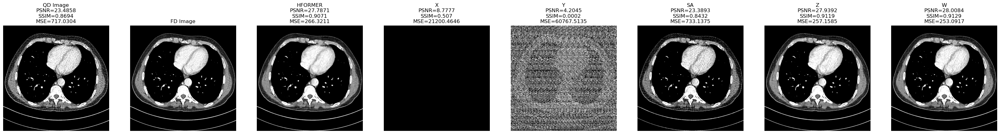

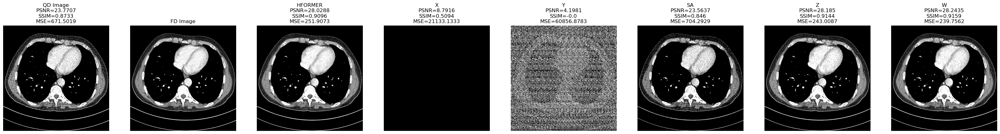

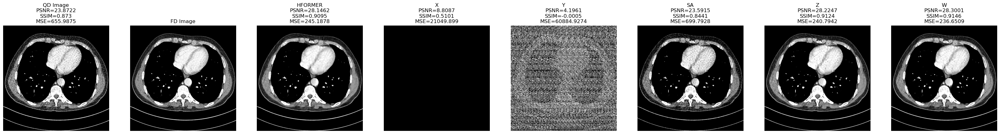

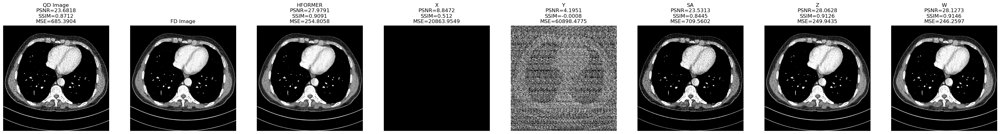

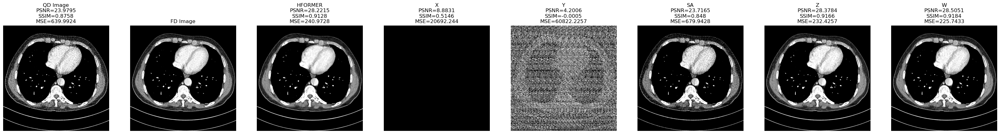

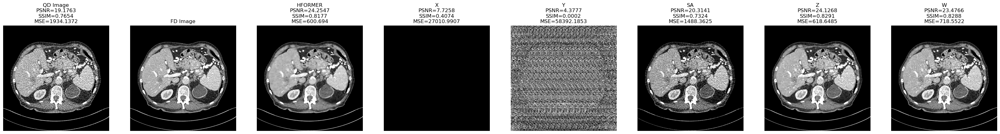

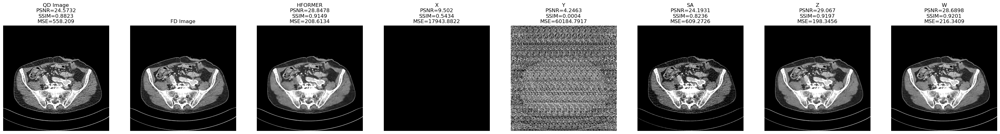

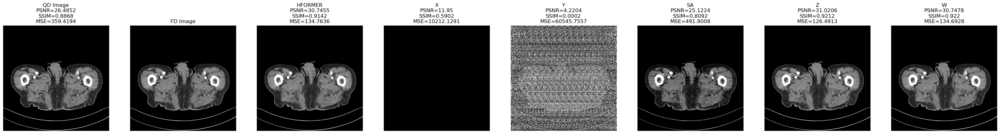

In [40]:

visualize_predictions_all_models(noisy_array, gt_array, len(gt_array), hformer_predictions, np.concatenate(x_model_prediction_patches, axis=0), np.concatenate(y_model_prediction_patches, axis=0), sa_predictions, z_predictions, w_predictions)